In [ ]:
# set main directory name
dir = dirname(pwd());

In [9]:
using DifferentialEquations
using JumpProcesses
using Plots
# using PlotlyJS
using Statistics
using Distributions
using Random
using JLD2
using HDF5

using Optimization
using OptimizationOptimJL
# using BlackBoxOptim

using CSV
using DataFrames
using DelimitedFiles

# include own module with functionalities, ATTENTION, this will include StatsPlots
include(joinpath(dir, "src/functionalities.jl"))

# set seed for reproducibility
Random.seed!(123);

# Cell division model
Notebokk with the result for the cell division model.

In [3]:
beta = 0.5
m_basal = 0.01
m_size = 0.003

m_sigma = 0.03
m_order = 1.0

d_size = 0.001
d_metastasis = 0.002
θ = [beta, m_basal, m_size, m_sigma, m_order, d_size, d_metastasis]
p = (beta = beta, m_basal = m_basal, m_size = m_size, m_sigma = m_sigma, m_order = m_order, d_size = d_size, d_metastasis = d_metastasis)

# initial conditions
S0 = 0.065

0.065

## Simulation

In [4]:
include("general_MNR_simulation_algorithm.jl")

simulate_many_MNR (generic function with 1 method)

In [4]:
# get exponential tumour growth
function expgrowth!(du, u, p, t)
    du[1] = p[1]* u[1]
end

function TumorPath(S0, p; endtime=30.0)
    prob = ODEProblem(expgrowth!, [S0], (0.0, endtime), [p.beta])
    sol = solve(prob, Tsit5(), reltol=1e-8, abstol=1e-8)
    return sol
end

TumorPath (generic function with 1 method)

In [ ]:
test_data = simulate_many_MNR(p, TumorPath, npat=500, S0=S0, metastatic_model="cell_division")

In [9]:
data_summary(test_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 23.7046
  "Low Quantile survival time:"  => 21.2119
  "Mean metastasis at day 10:"   => 0.812877
  "Mean metastasis at death:"    => 4.59753
  "Mean tumor size at day 10:"   => 7.4665
  "High Quantile survival time:" => 27.1277
  "Maximal metastasis number:"   => 13
  "Mean metastasis at day 20:"   => 3.13239
  "Patients died:"               => 405
  "Maximum metastasis increase:" => 4

In [3]:
# load data
npat = 500
data_path = joinpath(dir,"data/simplified_model/cell_division_data_$(npat)_patients_$(θ).jld2")
cell_division_data = load(data_path)["cell_division_data"];

In [6]:
data_summary(cell_division_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 24.1437
  "Low Quantile survival time:"  => 22.0002
  "Mean metastasis at day 10:"   => 0.521298
  "Mean metastasis at death:"    => 3.17371
  "Mean tumor size at day 10:"   => 9.63199
  "High Quantile survival time:" => 27.6126
  "Maximal metastasis number:"   => 11
  "Mean metastasis at day 20:"   => 2.15278
  "Patients died:"               => 426
  "Maximum metastasis increase:" => 4

In [47]:
sparse_data = DataFrame(patient_id = Int[], time = Float64[], tumor = Float64[], metastasis = Int[], death = Int[])
for id in unique(cell_division_data.patient_id)
    patient_data = cell_division_data[cell_division_data.patient_id .== id, :]
    len = size(patient_data, 1)
    new_patient_data = patient_data[sample(axes(patient_data, 1), ceil(Int, len/2); replace = false, ordered = true), :]
    # check if deathpoint is in there
    if sum(new_patient_data.death) == 0
        # if not, add it
        death_data = patient_data[patient_data.death .== 1, :]
        append!(new_patient_data, death_data)
    end
    append!(sparse_data, new_patient_data)
end

In [48]:
data_summary(sparse_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 23.9872
  "Low Quantile survival time:"  => 21.6795
  "Mean metastasis at day 10:"   => 0.879845
  "Mean metastasis at death:"    => 4.62903
  "Mean tumor size at day 10:"   => 9.6014
  "High Quantile survival time:" => 27.4444
  "Maximal metastasis number:"   => 14
  "Mean metastasis at day 20:"   => 2.97674
  "Patients died:"               => 434
  "Maximum metastasis increase:" => 6

In [49]:
# # save sparse data
# data_path = joinpath(pwd(),"data/simplified_model/sparse_cell_division_data_$(npat)_patients_$(θ)_promise2.jld2")
# save(data_path, "sparse_cell_division_data", sparse_data)

In [ ]:
# load sparse data
npat = 500
data_path = joinpath(dir,"data/simplified_model/sparse_cell_division_data_$(npat)_patients_$(θ)_promise2.jld2")
sparse_data = load(data_path)["sparse_cell_division_data"]

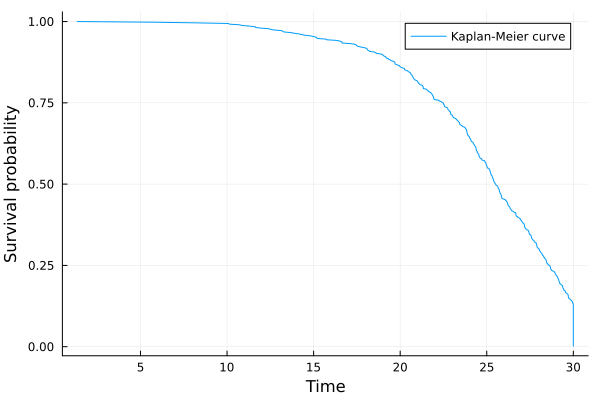

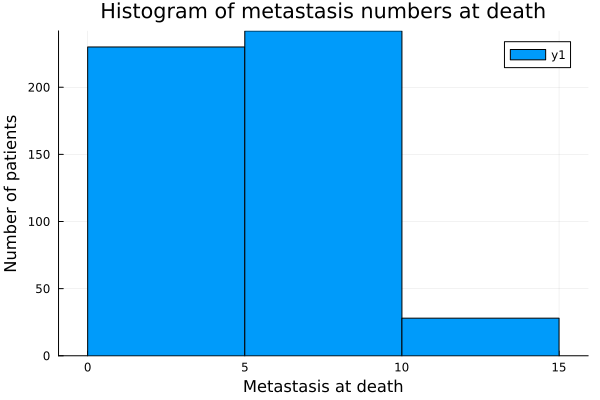

66 patients survived.

In [19]:
data_visualization(cell_division_data)

## Analytical vs. Numerical Likelihoods
Here, we want to evaluate the efficiency gain by the use of analytical likelihoods.

In [4]:
include(joinpath(dir, "scr/CellDivisionLikelihoods.jl"))
import .CellDivisionLikelihoods as CDL

In [24]:
x = [0.49, 0.027, 1.0, 0.00096, 0.00231];
test_res = @benchmark CDL.NumericNegLogLikelihood(x, cell_division_data, S0 = 0.065)

BenchmarkTools.Trial: 144 samples with 1 evaluation.
 Range (min … max):  30.825 ms … 50.102 ms  ┊ GC (min … max): 0.00% … 30.15%
 Time  (median):     34.339 ms              ┊ GC (median):    0.00%
 Time  (mean ± σ):   34.925 ms ±  1.973 ms  ┊ GC (mean ± σ):  2.65% ±  4.19%

                      ▁█▂ ▁▂ ▁▁                                
  ▃▁▁▃▃▁▁▁▁▁▁▁▁▁▁▃▁▁▁▄██████▄██▅▇▄▃▃▁▃█▅▆▅▅▁▃▄▇▅▃▆▅▃▅▅▁▄▃▃▅▅▅ ▃
  30.8 ms         Histogram: frequency by time        37.9 ms <

 Memory estimate: 15.73 MiB, allocs estimate: 409350.

In [62]:
# load benchmark results from csv to dataframe
benchmark_df = CSV.read(joinpath(dir,"output/results/benchmark_cell_division_likelihoods_$(npat)_patients_$(θ).csv", DataFrame));

# convert strings in the time columns to floats
benchmark_df.Analytic_Time = [parse(Float64,split(split(benchmark_df.Analytic_Time[i], " ")[1], "(")[2])
                                for i in eachindex(benchmark_df.Analytic_Time)]
benchmark_df.Numeric_Time = [parse(Float64,split(split(benchmark_df.Numeric_Time[i], " ")[1], "(")[2])
                                for i in eachindex(benchmark_df.Numeric_Time)] 
benchmark_df.FG_Time = [parse(Float64,split(split(benchmark_df.FG_Time[i], " ")[1], "(")[2])
                                for i in eachindex(benchmark_df.FG_Time)];

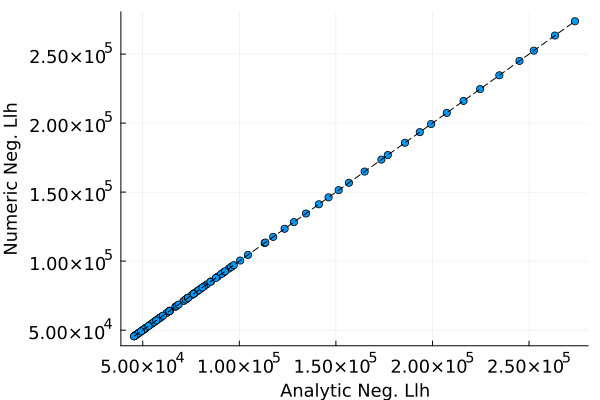

In [132]:
# plot numeric vs analytical llh values
plot(benchmark_df.Analytic_Value, benchmark_df.Numeric_Value,  xlabel="Analytic Neg. Llh", ylabel="Numeric Neg. Llh", seriestype=:scatter, legend=false)
plot!(minimum(benchmark_df.Analytic_Value):maximum(benchmark_df.Analytic_Value),
    minimum(benchmark_df.Analytic_Value):maximum(benchmark_df.Analytic_Value),
    color=:black, linestyle=:dash, label="y=x")
plot!(tickfontsize=12, legenfontsize=12, guidefontsize=12, titlefontsize=12)
# savefig("figures/ode_paper/benchmark_numeric_vs_analytic_llh_cell_division_$(npat)_patients_$(θ).pdf")

In [129]:
bplt1 = scatter(ones(100),benchmark_df.Analytic_Time, xlimit=(0.0, 3.0), label="Analytic Times", color=:blue)
@df benchmark_df boxplot!(bplt1, ones(100),:Analytic_Time, label=false, color=:blue, fillalpha=0.5, ylabel="Time [ms]")

scatter!(bplt1, ones(100)*2,benchmark_df.Numeric_Time, xlimit=(0.0, 3.0), label="Numeric Times", color=:orange)
@df benchmark_df boxplot!(bplt1, ones(100)*2,:Numeric_Time, label=false, color=:orange, fillalpha=0.5, ylabel="Time [ms]")
plot!(bplt1, xticks =([1, 2], ["Analytic", "Numeric"]), xlabel="Method")

plot!(bplt1, legendfontsize=12, tickfontsize=12)

# StatsPlots.plot(bplt1, bplt2)
# savefig("figures/ode_paper/benchmark_times_boxplot_cell_division_$(npat)_patients_$(θ).pdf")

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/benchmark_times_boxplot_cell_division_500_patients_[0.5, 0.01, 0.003, 0.03, 1.0, 0.001, 0.002].pdf"

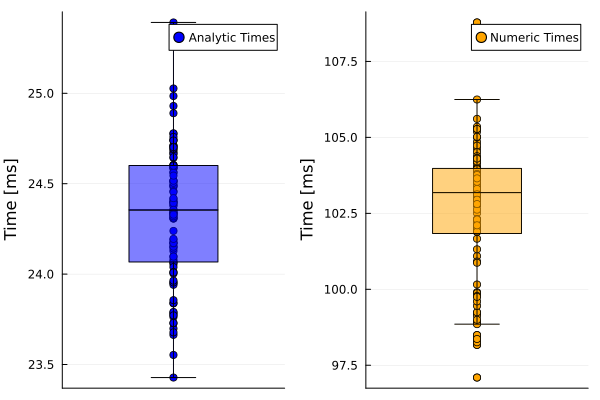

In [11]:
bplt1 = scatter(ones(100),benchmark_df.Analytic_Time, xlimit=(0.0, 2.0), label="Analytic Times", color=:blue, xticks=false)
@df benchmark_df boxplot!(bplt1, ones(100),:Analytic_Time, label=false, color=:blue, fillalpha=0.5, ylabel="Time [ms]")

bplt2 = scatter(ones(100),benchmark_df.Numeric_Time, xlimit=(0.0, 2.0), label="Numeric Times", color=:orange, xticks=false)
@df benchmark_df boxplot!(bplt2, ones(100),:Numeric_Time, label=false, color=:orange, fillalpha=0.5, ylabel="Time [ms]")


StatsPlots.plot(bplt1, bplt2)

In [ ]:
# for the below to work one should not import Plots and StatsPlots somewhere (so comment it ou in the above preambel!)

using Makie
using CairoMakie

f = Figure()

lims = Observable(((20.0, 35.0), (95.0, 110.0)))

g = f[1, 1] = GridLayout()

ax_top = Axis(f[1, 1][1, 1], title = "Computation time comparison", titlesize=20)
ax_bottom = Axis(f[1, 1][2, 1], xlabel="Method", xlabelsize=18, ylabel="                                  Time [ms]", 
ylabelsize=20, xtickformat= values -> ["Analytic", " ", "Numeric"])

on(lims) do (bottom, top)
    ylims!(ax_bottom, bottom)
    ylims!(ax_top, top)
    rowsize!(g, 1, Auto(top[2] - top[1]))
    rowsize!(g, 2, Auto(bottom[2] - bottom[1]))
end

hidexdecorations!(ax_top, grid = false)
ax_top.bottomspinevisible = false
ax_bottom.topspinevisible = false

linkxaxes!(ax_top, ax_bottom)
rowgap!(g, 10)

angle = pi/8
linelength = 30

segments = lift(
        @lift($(ax_top.yaxis.attributes.endpoints)[1]),
        @lift($(ax_bottom.yaxis.attributes.endpoints)[2]),
        @lift($(ax_top.elements[:yoppositeline][1])[1]),
        @lift($(ax_bottom.elements[:yoppositeline][1])[2]),
    ) do p1, p2, p3, p4
    ps = Point2f[p1, p2, p3, p4]
    
    map(ps) do p
        a = p + Point2f(cos(angle), sin(angle)) * 0.5 * linelength
        b = p - Point2f(cos(angle), sin(angle)) * 0.5 * linelength
        (a, b)
    end
end

linesegments!(f.scene, segments)

Makie.scatter!(ax_top, ones(100)*2 , benchmark_df.Numeric_Time, color=:orange)
Makie.boxplot!(ax_top, ones(100)*2 , benchmark_df.Numeric_Time, color=(:orange, 0.5), whiskerwidth=0.5)
Makie.scatter!(ax_bottom, ones(100)*1, benchmark_df.Analytic_Time, color=:blue)
Makie.boxplot!(ax_bottom, ones(100)*1 , benchmark_df.Analytic_Time, color=(:blue, 0.5), whiskerwidth=0.5)

notify(lims)

f

# save(joinpath(dir,"figures/ode_paper/benchmark_times_cell_division_likelihoodds_$(npat)_patients_$(θ).pdf", f))

In [34]:
example_par = [0.5, 0.03, 1.0, 0.001, 0.002]

5-element Vector{Float64}:
 0.5
 0.03
 1.0
 0.001
 0.002

In [35]:
@btime CDL.NegLogLikelihood(example_par, cell_division_data, S0=0.065)

  5.852 ms (147221 allocations: 8.95 MiB)


45248.38952983854

In [28]:
@btime CDL.NumericNegLogLikelihood(example_par, cell_division_data, S0=0.065, reltol = 1e-4)

  36.083 ms (409350 allocations: 15.73 MiB)


75207.99804719498

In [25]:
@btime CDL.NumericNegLogLikelihood(example_par, cell_division_data, S0=0.065, reltol = 1e-6)

  31.280 ms (569200 allocations: 24.24 MiB)


65091.77467847725

In [26]:
@btime CDL.NumericNegLogLikelihood(example_par, cell_division_data, S0=0.065, reltol = 1e-8)

  28.806 ms (569200 allocations: 24.24 MiB)


65091.77467847725

In [29]:
@btime CDL.NumericNegLogLikelihood(example_par, cell_division_data, S0=0.065, reltol = 1e-10)

  33.592 ms (409350 allocations: 15.73 MiB)


75207.9980473739

In [30]:
@btime CDL.FGNegLogLikelihood(example_par, cell_division_data, S0=0.065)

  80.938 ms (624506 allocations: 69.10 MiB)


75207.99804224243

We see a speed-up of around the 4x-fold for the function evaluation. Let's see how this translates to the inference.

## Inference

In [5]:
using BenchmarkTools
using LatinHypercubeSampling

log_lb_x0 = [-0.75, -4, -9, -9]
log_ub_x0 = [-0.65, -2, -4, -4]

n_starts = 100 

plan,_ = LHCoptim(n_starts, length(log_lb_x0), 1000)
scaled_plan = scaleLHC(plan, [(log_lb_x0[i], log_ub_x0[i]) for i in eachindex(log_lb_x0)]);

x0_vectors = [scaled_plan[i, :] for i in 1:size(scaled_plan, 1)];

# save startpoints
# save(joinpath(dir, "data/startpoints_cell_division_likelihoods_$(n_starts)_starts_$(npat)_patients_$(θ).jld2", "startpoints", x0_vectors))

x0_vectors = load(joinpath(dir, "data/startpoints_cell_division_likelihoods_$(n_starts)_starts_$(npat)_patients_$(θ).jld2"))["startpoints"];

In [ ]:
# MAKE SURE ONLY THE CORRECT LIKELIHOOD SCRIPT IS LOADED! And be aware of fixed parameter m_order in the analytical likelihood.

# get likelihood with data
lb = zeros(4) .+ 1e-6
ub = zeros(4) .+ 1
function llh_red(p, x)
    par = [p[1], p[2], 1, p[3], p[4]]
    return -OdeLogLikelihood(par, patient_df, S0=0.065)
end

θ_red = [0.48, 0.03, 0.003, 0.003]

# define optimization problem
optf = OptimizationFunction(llh_red, Optimization.AutoForwardDiff());
opt_problem = OptimizationProblem(optf, θ_red, lb=lb, ub=ub);

sol = solve(opt_problem, SAMIN(), maxiters = 10^5, maxtime=600.0)

LBFGS doees not work on that likelihood function, which is really surprising. It is because it does not work on the death likelihood, but why is the question. It is just analytical functions...

No it is not, the incomplete upper gamma function is not.

In [15]:
Optim(x, p) = CDL.TumorNegLogLikelihood(x[1], cell_division_data, S0=0.065)
OptimFunc = OptimizationFunction(Optim, Optimization.AutoForwardDiff())
OptimProblem = OptimizationProblem(OptimFunc, [0.49], lb=zeros(1).+1e-4, ub=[1])
Est = solve(OptimProblem, LBFGS(), maxiters=10^5, maxtime=150.0)
println("beta:", Est[1], "\n",)

beta:0.5000401898878934



In [16]:
metOptim(x, p) = CDL.MetastasisNegLogLikelihood([Est[1], x[1], 1.0], cell_division_data, S0=0.065)
metOptimFunc = OptimizationFunction(metOptim, Optimization.AutoForwardDiff())
metOptimProblem = OptimizationProblem(metOptimFunc, [0.05], lb=zeros(1).+1e-4, ub=ones(1))
metEst = solve(metOptimProblem, LBFGS(), maxiters=10^5)
println("Metastasis:", metEst, "\n")

Metastasis:retcode: Success
u: [0.04338163954939994]
Final objective value:     6282.549559194738




In [17]:
deathOptim(x, p) = CDL.DeathNegLogLikelihood([Est[1], metEst[1], 1.0, x[1], x[2]], cell_division_data)
deathOptimFunc = OptimizationFunction(deathOptim, Optimization.AutoForwardDiff())
deathOptimProblem = OptimizationProblem(deathOptimFunc, [0.005, 0.005], lb=zeros(2).+1e-4, ub=ones(2))
deathEst = solve(deathOptimProblem, SAMIN(), maxiters=10^5, maxtime= 600.0)
est_par = [Est[1], metEst[1], 1.0, deathEst[1], deathEst[2]]

# print solutions
#println("True parameter is \n", true_par)
println("Estimated parameter is \n", est_par)

SAMIN results
==> Normal convergence <==
total number of objective function evaluations: 19601

     Obj. value:   1382.4277543871

       parameter      search width
         0.00117           0.00000 
         0.00118           0.00000 

Estimated parameter is 
[0.5000401898878934, 0.04338163954939994, 1.0, 0.0011712885751433946, 0.0011809484465622403]


In [18]:
CDL.DeathNegLogLikelihood(est_par, cell_division_data)

1382.4277543871328

In [19]:
true_par = [0.5, 0.03, 1.0, 0.001, 0.002]
CDL.DeathNegLogLikelihood(true_par, cell_division_data)

1385.491730267512

In [7]:
# load optimization result
using FileIO
optimizer="LBFGS"
Llh_Type="Analytic"
nstarts = 100
LBFGS_result_path = joinpath(dir,"output/results/test_cell_division_joined_optimization_$(nstarts)_starts_$(optimizer)_distributed_$(Llh_Type).jld2")
LBFGS_results = load(LBFGS_result_path)["results"]
LBFGS_par_names = LBFGS_results["par_names"]
cell_division_par_names = LBFGS_par_names
LBFGS_results = LBFGS_results["optimization_results"]
LBFGS_nllhs_list = [LBFGS_results[i]["nllh"] for i in 1:nstarts]
LBFGS_par_list = [LBFGS_results[i]["parameter"] for i in 1:nstarts]
LBFGS_mean_time = mean([LBFGS_results[i]["time_trace"][end] for i in 1:nstarts])
LBFGS_max_time = maximum([LBFGS_results[i]["time_trace"][end] for i in 1:nstarts])

┌ Warning: type Main.CellDivisionLikelihoods.#Optim#72{Float64,DataFrame} does not exist in workspace; reconstructing
└ @ JLD2 /home/vincent/.julia/packages/JLD2/bfPAo/src/data/reconstructing_datatypes.jl:633
┌ Warning: some parameters could not be resolved for type OptimizationFunction{true,AutoForwardDiff{nothing, Nothing},JLD2.ReconstructedMutable{Symbol("#Optim#72{Float64,DataFrame}"), (:S0, :data), Tuple{Float64, Any}},Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME),Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing}; reading as OptimizationFunction{true, AutoForwardDiff{nothing, Nothing}, JLD2.ReconstructedMutable{Symbol("#Optim#72{Float64,DataFrame}"), (:S0, :data), Tuple{Float64, Any}}, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME), Nothing, Nothing, Nothing, Nothing, Nothing, Noth

5.755871036

In [8]:
LBFGS_mean_time

3.80464978134

In [7]:
using JSON
optimizer="LBFGS"
Llh_Type="Analytic"
nstarts = 100
file = joinpath(dir,"output/results/test_cell_division_joined_optimization_$(nstarts)_starts_$(optimizer)_distributed_$(Llh_Type).json")
open(file, "r") do f
    global LBFGS_res = JSON.parse(f)
end
LBFGS_par_names = LBFGS_res["par_names"]
cell_division_par_names = LBFGS_par_names
LBFGS_res = LBFGS_res["optimization_results"]
LBFGS_nllhs_list = [LBFGS_res[i]["nllh"] for i in 1:nstarts]
LBFGS_par_list = [LBFGS_res[i]["parameter"] for i in 1:nstarts]
LBFGS_mean_time = mean([LBFGS_res[i]["time_trace"][end] for i in 1:nstarts])
LBFGS_max_time = maximum([LBFGS_res[i]["time_trace"][end] for i in 1:nstarts])

5.755871036

In [5]:
# load optimization result
optimizer="SAMIN"
Llh_Type="Analytic"
nstarts = 100
Analytic_result_path = joinpath(dir,"output/results/cell_division_joined_optimization_$(nstarts)_starts_$(optimizer)_distributed_$(Llh_Type).jld2")
Analytic_results = load(Analytic_result_path)["results"]
Analytic_par_names = Analytic_results["par_names"]
cell_division_par_names = Analytic_par_names
Analytic_results = Analytic_results["optimization_results"]
Analytic_nllhs_list = [Analytic_results[i]["nllh"] for i in 1:nstarts]
Analytic_par_list = [Analytic_results[i]["parameter"] for i in 1:nstarts]
Analytic_mean_time = mean([Analytic_results[i]["time_trace"][end] for i in 1:nstarts])
Analytic_max_time = maximum([Analytic_results[i]["time_trace"][end] for i in 1:nstarts])

┌ Warning: type Main.CellDivisionLikelihoods.#OptimLlh#72{Float64,DataFrame} does not exist in workspace; reconstructing
└ @ JLD2 /home/vincent/.julia/packages/JLD2/bfPAo/src/data/reconstructing_datatypes.jl:633
┌ Warning: some parameters could not be resolved for type OptimizationFunction{true,AutoForwardDiff{nothing, Nothing},JLD2.ReconstructedMutable{Symbol("#OptimLlh#72{Float64,DataFrame}"), (:S0, :data), Tuple{Float64, Any}},Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME),Nothing,Nothing,Nothing,Nothing,Nothing,Nothing,Nothing}; reading as OptimizationFunction{true, AutoForwardDiff{nothing, Nothing}, JLD2.ReconstructedMutable{Symbol("#OptimLlh#72{Float64,DataFrame}"), (:S0, :data), Tuple{Float64, Any}}, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME), Nothing, Nothing, Noth

850.880417933

In [39]:
# load optimization result
optimizer="SAMIN"
Llh_Type="Numeric"
nstarts = 100
Numeric_result_path = joinpath(dir,"output/results/cell_division_joined_optimization_$(nstarts)_starts_$(optimizer)_distributed_$(Llh_Type).jld2")
Numeric_results = load(Numeric_result_path)["results"]
Numeric_par_names = Numeric_results["par_names"]
Numeric_results = Numeric_results["optimization_results"]
Numeric_nllhs_list = [Numeric_results[i]["nllh"] for i in 1:nstarts]
Numeric_par_list = [Numeric_results[i]["parameter"] for i in 1:nstarts]
Numeric_mean_time = mean([Numeric_results[i]["time_trace"][end] for i in 1:nstarts]) 
Numeric_max_time = maximum([Numeric_results[i]["time_trace"][end] for i in 1:nstarts])

┌ Warning: type Main.CellDivisionLikelihoods.#NumericOptimLlh#73{Float64,DataFrame} does not exist in workspace; reconstructing
└ @ JLD2 /home/vincent/.julia/packages/JLD2/cHcDY/src/data/reconstructing_datatypes.jl:605
┌ Warning: type Optimization.OptimizationForwarddiffExt.#37#55{OptimizationFunction{true, AutoForwardDiff{nothing, Nothing}, JLD2.ReconstructedMutable{Symbol("#NumericOptimLlh#73{Float64,DataFrame}"), (:S0, :data), Tuple{Float64, Any}}, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing},Optimization.ReInitCache{Vector{Float64}, SciMLBase.NullParameters}} does not exist in workspace; reconstructing
└ @ JLD2 /home/vincent/.julia/packages/JLD2/cHcDY/src/data/reconstructing_datatypes.jl:605
┌ Warning: type Optimization.OptimizationForwarddiffExt.#38#56{ForwardDiff.GradientConfig{ForwardDiff.Tag{JLD2.Recon

2231.136895468

In [11]:
Numeric_nllhs_list[end], Analytic_nllhs_list[end], LBFGS_nllhs_list[end]

(45246.96474422889, 45246.96474422759, 45246.96474422874)

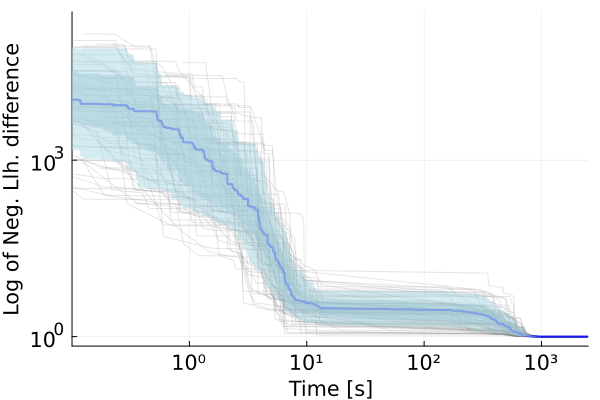

In [50]:
optimizer ="LBFGS"
nstarts = 100
Llh_type = "Numeric"
xlimits = (-1.0, log10(max(Numeric_max_time, Analytic_max_time)))

optimizer_trace_plots(Numeric_results, xlim=xlimits)
# savefig(joinpath(pwd(), "figures/ode_paper/trace_plot_cell_division_$(nstarts)_starts_$(optimizer)_$(Llh_type).pdf"))

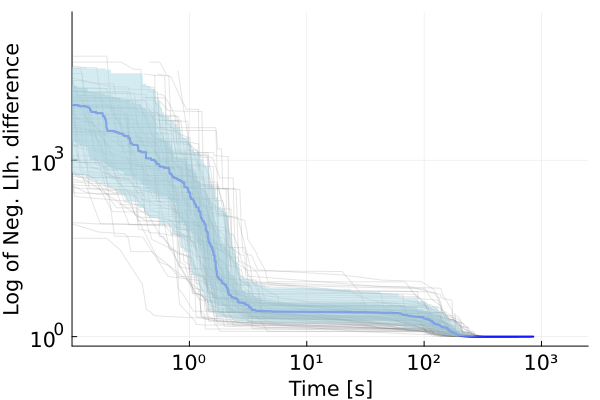

In [49]:
optimizer ="LBFGS"
nstarts = 100
Llh_type = "Analytic"
xlimits = (-1.0, log10(max(Numeric_max_time, Analytic_max_time)))

optimizer_trace_plots(Analytic_results, xlim=xlimits)
# savefig(joinpath(pwd(), "figures/ode_paper/trace_plot_cell_division_$(nstarts)_starts_$(optimizer)_$(Llh_type).pdf"))

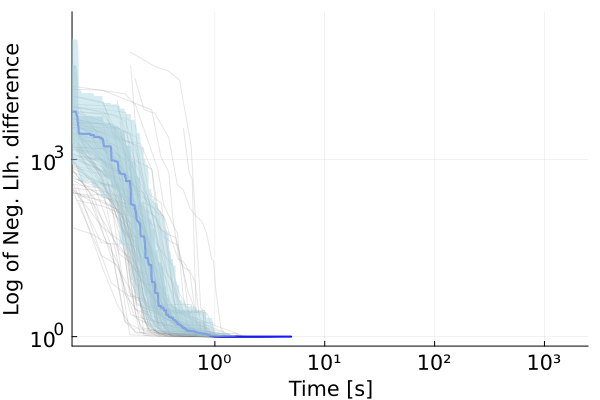

In [55]:
optimizer ="LBFGS"
nstarts = 100
Llh_type = "Analytic"
xlimits = (-1.3, log10(max(Numeric_max_time, Analytic_max_time)))

optimizer_trace_plots(LBFGS_res, xlim=xlimits)
#savefig(joinpath(pwd(), "figures/ode_paper/trace_plot_cell_division_$(nstarts)_starts_$(optimizer)_$(Llh_type).pdf"))

Analytical is faster.

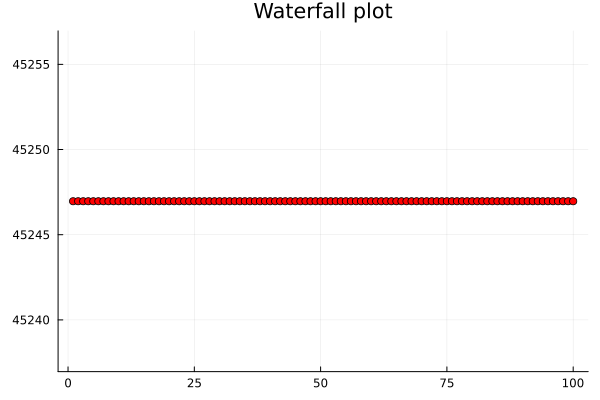

"Analytic"

In [20]:
# plot waterfall plot
cg = cgrad(:hsv, range(0, 1, length=nstarts))

perm = sortperm(Analytic_nllhs_list)
Analytic_nllhs_list .= Analytic_nllhs_list[perm]
Analytic_par_list .= Analytic_par_list[perm]

# set grouping by fval for color
rel_threshold = 1
k = 1
z = zeros(nstarts)
for i in 1:nstarts
    if i == 1
        z[i] = k
    else
        if Analytic_nllhs_list[i] - Analytic_nllhs_list[i-1] <= rel_threshold
            z[i] = k
        else
            k = k + 1
            z[i] = k
        end
    end
end

# cg = cgrad(:hsv, range(0, 1, length=Int(z[end])))

plt = Plots.plot(Analytic_nllhs_list, linecolor=:black, legend=false, title="Waterfall plot", ylimit=(Analytic_nllhs_list[1]-10, Analytic_nllhs_list[1]+10))
display(Plots.scatter!(plt, Analytic_nllhs_list,  color=cg[Int.(z)], legend=false, title="Waterfall plot"))


optimizer = "SAMIN"
nstarts = 100
Llh_type = "Analytic"
# savefig(joinpath(dir, "figures/ode_paper/waterfall_plot_cell_division_joined_optimization_$(optimizer)_$(nstarts)_starts_$(Llh_type).pdf"))


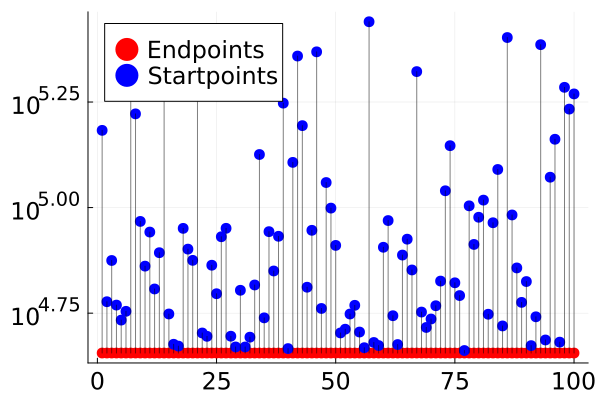

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/double_waterfall_plot_cell_division_joined_optimisation_SAMIN_100_starts_Analytic.pdf"

In [26]:
# plot waterfall plot
x0_nllhs = [CDL.NegLogLikelihood([exp.(x0_vectors[i][1:2])..., 1.0, exp.(x0_vectors[i][3:4])...] , cell_division_data, S0=0.065) for i in 1:nstarts];
cg = cgrad(:hsv, range(0, 1, length=nstarts))

perm = sortperm(Analytic_nllhs_list)
Analytic_nllhs_list .= Analytic_nllhs_list[perm]
Analytic_par_list .= Analytic_par_list[perm]

# set grouping by fval for color
rel_threshold = 1
k = 1
z = zeros(nstarts)
for i in 1:nstarts
    if i == 1
        z[i] = k
    else
        if Analytic_nllhs_list[i] - Analytic_nllhs_list[i-1] <= rel_threshold
            z[i] = k
        else
            k = k + 1
            z[i] = k
        end
    end
end

# cg = cgrad(:hsv, range(0, 1, length=Int(z[end])))
gr(markerstrokewidth=0,markersize=6)
plt = Plots.plot(Analytic_nllhs_list, linecolor=:black,label=false,  yscale=:log10, legend=:best)
Plots.scatter!(plt, 1:1:100, Analytic_nllhs_list,  color=cg[Int.(z)], markershape=:circle, label="Endpoints")
scatter!(plt, 1:1:100, x0_nllhs, color=:blue, label="Startpoints")
for i in 1:n_starts
    plot!(plt, [i, i], [x0_nllhs[i], Analytic_nllhs_list[i]], color=:black, label=false, alpha=0.5)
end
plot!(plt, legendfontsize=16, tickfontsize=16, guidefontsize=16)
display(plt)
optimizer = "SAMIN"
nstarts = 100
Llh_type = "Analytic"
savefig(joinpath(dir, "figures/ode_paper/double_waterfall_plot_cell_division_joined_optimisation_$(optimizer)_$(nstarts)_starts_$(Llh_type).pdf"))

In [61]:
using MultivariateStats
extended_x0_vectors = [[x0_vectors[i][1:2]..., 1.0, x0_vectors[i][3:4]...] for i in 1:nstarts];


x0_Matrix = permutedims(hcat(extended_x0_vectors...))
result_Matrix = permutedims(hcat(Analytic_par_list...))

full_matrix = transpose(vcat(x0_Matrix, result_Matrix))

full_PCA = fit(PCA, full_matrix; maxoutdim = 2);

full_prediction = predict(full_PCA, full_matrix)
# projection = x0_PCA.proj

scatter(full_prediction[1,1:100], full_prediction[2,1:100], label="Startpoints", xlabel="PC1", ylabel="PC2", legend=:topright)
scatter!(full_prediction[1,101:200], full_prediction[2,101:200], label="Optimization Results", color=:red)

savefig(joinpath(dir, "figures/ode_paper/PCA_cell_division_joined_optimization_$(optimizer)_$(nstarts)_starts.pdf"))

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/PCA_cell_division_joined_optimization_SAMIN_100_starts.pdf"

## Sampling
Using Pypesto Adaptive parallel tempering algorithm.

In [9]:
using MCMCChains
using StatsPlots
using HDF5

In [10]:
# load result hdf5 file
n_iter = 1000000
n_chains = 10
result_path = joinpath(dir, "output/simplified_model/sampling_cell_division_data_$(n_chains)chs_$(n_iter)it_$(θ).h5")
chain_dict = h5open(result_path, "r") do file
    read(file,)
end
chain = dict_to_chain(chain_dict, cell_division_par_names, n_chains, n_iter)

Chains MCMC chain (1000001×4×10 Array{Float64, 3}):

Iterations        = 1:1:1000001
Number of chains  = 10
Samples per chain = 1000001
parameters        = beta, m_sigma, d_size, d_metastasis

Summary Statistics
    parameters      mean       std      mcse      ess_bulk      ess_tail       ⋯
        Symbol   Float64   Float64   Float64       Float64       Float64   Flo ⋯

          beta    0.5000    0.0001    0.0000   694840.6866   954735.8634    1. ⋯
       m_sigma    0.0293    0.0008    0.0000   650131.6910   895631.8650    1. ⋯
        d_size    0.0010    0.0001    0.0000   623562.7425   844635.1540    1. ⋯
  d_metastasis    0.0017    0.0013    0.0000   597674.5882   724287.8862    1. ⋯
                                                               2 columns omitted

Quantiles
    parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
        Symbol   Float64   Float64   Float64   Float64   Float64 

          beta    0.4999    0.4999    0.5000    0.5000    0.5001
       m_si

In [11]:
burn_in = burn_in_from_geweke(chain)
if burn_in >= length(chain)
    burn_in = Int(floor(length(chain)/2))
    
end

500000

In [ ]:
StatsPlots.plot(chain[burn_in:end])

In [12]:
example_par = exp.(Analytic_par_list[1])
true_par = [beta, m_sigma, d_size, d_metastasis]
example_res_df = DataFrame(parameter=Analytic_par_names, value=[example_par[1:2]...,example_par[4:5]...], true_value=true_par)

for id in eachindex(Analytic_par_names)
    par = Analytic_par_names[id]
    plt = StatsPlots.plot(chain[burn_in:end, par,:], seriestype=:density, label=false)
    vline!(plt, [example_res_df[example_res_df.parameter .== par, :true_value]], color="black", label="true value", linewidth=2)
    vline!(plt, [example_res_df[example_res_df.parameter .== par, :value]], color="red", label="MLE", linewidth=2)
    x_ticks = LinRange(minimum(chain[burn_in:end, par,:]), maximum(chain[burn_in:end, par,:]), 5)
    plot!(legendfontsize=16, tickfontsize=16, guidefontsize=16, title="", xticks = (x_ticks, round.(x_ticks, digits=5)))
    save_path = joinpath(dir, "figures/ode_paper/density_$(par)_cell_division_model.pdf")
    Plots.savefig(plt, save_path)
end

In [21]:
par_quantiles = quantile(chain[burn_in:end]; q=[0.01, 0.025, 0.05, 0.1, 0.5, 0.9, 0.95, 0.975, 0.99])

Quantiles
    parameters      1.0%      2.5%      5.0%     10.0%     50.0%     90.0%     ⋯
        Symbol   Float64   Float64   Float64   Float64   Float64   Float64   F ⋯

          beta    0.4998    0.4999    0.4999    0.4999    0.5000    0.5000     ⋯
       m_sigma    0.0277    0.0280    0.0282    0.0284    0.0293    0.0302     ⋯
        d_size    0.0008    0.0008    0.0009    0.0009    0.0010    0.0010     ⋯
  d_metastasis    0.0001    0.0002    0.0003    0.0005    0.0016    0.0029     ⋯
                                                               3 columns omitted


In [22]:
example_par = exp.(Analytic_par_list[1])
true_par = [beta, m_sigma, d_size, d_metastasis]

4-element Vector{Float64}:
 0.5
 0.03
 0.001
 0.002

In [101]:
[exp.(Analytic_par_list[1])[1:2]..., exp.(Analytic_par_list[1])[4:5]...]

4-element Vector{Float64}:
 0.49997778954699384
 0.02931502069012877
 0.0009600725753418397
 0.0014009131230802022

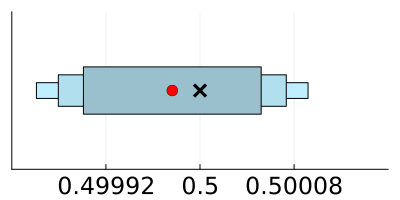

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/cell_division_beta_estimate_cis.pdf"

In [38]:
par_id = 1
example_par = [exp.(Analytic_par_list[1])[1:2]..., exp.(Analytic_par_list[1])[4:5]...]
true_par = [beta, m_sigma, d_size, d_metastasis]
plt = bar([0.5],
    [par_quantiles.nt[9][par_id]], 
    fillto=[par_quantiles.nt[3][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    orientation=:h, 
    bar_width=0.1,
    color=:lightblue1, 
    label="80%CI")
bar!(plt, [0.5],
    [par_quantiles.nt[8][par_id]], 
    fillto=[par_quantiles.nt[4][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    orientation=:h, 
    bar_width=0.2,
    color=:lightblue2, 
    label="90%CI")
bar!(plt, [0.5],
    [par_quantiles.nt[7][par_id]], 
    fillto=[par_quantiles.nt[5][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    ylimits=(0.0, 1.0),
    orientation=:h, 
    bar_width=0.3, 
    color=:lightblue3,
    yticks=false,
    label="95%CI")
plot!([example_par[par_id]],[0.5], seriestype=:scatter, label="MLE", color=:red, markersize=6)
plot!([true_par[par_id]],[0.5], seriestype=:scatter, marker=:xcross, markerstrokewidth=8, label="True", color=:black, markersize=6)
x = true_par[par_id]
x_lower_limit = x-max(x-par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]-x)
x_upper_limit = x+max(x-par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]-x)
plot!(xlimits=(x_lower_limit, x_upper_limit))
x_ticks = LinRange(x_lower_limit, x_upper_limit, 5)[2:end-1]
plot!(xticks = (x_ticks, round.(x_ticks, digits=5)))
plot!(size=(400, 200), formatter=:plain, legend=false, tickfontsize=16, legendfontsize=16, guidefontsize=16)
display(plt)
savefig(joinpath(dir, "figures/ode_paper/cell_division_$(cell_division_par_names[par_id])_estimate_cis.pdf"))
